<div style='font-size:100%;'>
    <a id='import'></a>
    <h1 style='color: black; font-weight: bold; font-family: Cascadia code;'>
        <center> Importing necessary libraries 📚 </center>
    </h1>
 
</div> 

In [1]:
import pandas as pd
from chembl_webresource_client.new_client import new_client
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from warnings import filterwarnings
from rdkit.Chem import Descriptors, Lipinski
import numpy as np
from rdkit import Chem
from rdkit.Chem import Draw, PandasTools
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from tensorflow import keras
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.impute import SimpleImputer

<div style='font-size:100%;'>
    <a id='clean'></a>
    <h1 style='color: black; font-weight: bold; font-family: Cascadia code;'>
        <center> Importing the dataset ⬇️ </center>
    </h1>
</div>

In [3]:
# Set options
filterwarnings("ignore")
pd.set_option('display.max_columns',45)
pd.set_option('display.max_rows', None)
#Import
target = new_client.target
# Set path to this notebook
HERE = Path(_dh[-1])
DATA = HERE / "data"
target_query = target.search('Inflammatory bowel disease')
targets = pd.DataFrame.from_dict(target_query)
selected_target = targets.target_chembl_id[79]
activity = new_client.activity
res = activity.filter(target_chembl_id=selected_target).filter(standard_type="IC50")
df = pd.DataFrame.from_dict(res)
df

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,assay_variant_accession,assay_variant_mutation,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,311417,[],CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,None,None,BAO_0000190,BAO_0000019,assay format,COc1ccc([C@]2(C#N)CC[C@@H](C(=O)O)CC2)cc1OC1CCCC1,None,None,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '20.97', 'le': '0.39', 'lle': '3.15', ...",CHEMBL511115,CILOMILAST,CHEMBL511115,7.20,0,http://www.openphacts.org/units/Nanomolar,137040,=,1,1,=,None,IC50,nM,None,63.0,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,nM,UO_0000065,None,63.0
1,None,315297,[],CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,None,None,BAO_0000190,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3cccc([N+](=O)[O-]...,None,None,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '24.24', 'le': '0.44', 'lle': '4.43', ...",CHEMBL74078,None,CHEMBL74078,9.00,1,http://www.openphacts.org/units/Nanomolar,137041,=,1,1,=,None,IC50,nM,None,1.0,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,nM,UO_0000065,None,1.0
2,None,316479,[],CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,None,None,BAO_0000190,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3ccc4nonc4c3)n2)cc1,None,None,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '23.96', 'le': '0.43', 'lle': '4.62', ...",CHEMBL77826,None,CHEMBL77826,8.82,1,http://www.openphacts.org/units/Nanomolar,137039,=,1,1,=,None,IC50,nM,None,1.5,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,nM,UO_0000065,None,1.5
3,None,904630,[],CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,None,None,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,None,None,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '16.48', 'le': '0.31', 'lle': '2.84', ...",CHEMBL97817,None,CHEMBL97817,7.66,0,http://www.openphacts.org/units/Nanomolar,182108,=,1,1,=,None,IC50,nM,None,22.0,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,uM,UO_0000065,None,0.022
4,None,904635,[],CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,None,None,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,None,None,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,None,CHEMBL319809,None,CHEMBL319809,None,0,http://www.openphacts.org/units/Nanomolar,182093,>,1,1,>,None,IC50,nM,None,100000.0,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,uM,UO_0000065,None,100.0
5,None,906408,[],CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,None,None,BAO_0000190,BAO_0000019,assay format,COc1ccc([C@]2(C#N)CC[C@@H](C(=O)O)CC2)cc1OC1CCCC1,None,None,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '20.68', 'le': '0.39', 'lle': '3.05', ...",CHEMBL511115,CILOMILAST,CHEMBL511115,7.10,0,http://www.openphacts.org/units/Nanomolar,313944,=,1,1,=,None,IC50,nM,None,79.0,CHEMBL288,Homo sapiens,Phosphodiesterase 4D,9606,None,None,IC50,uM,UO_0000065,None,0.079
6,None,907422,[],CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,None,None,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,None,None,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,None,CHEMBL330641,5.70,0,http://www.openphacts.org/units/Nanomolar,182091,=,1,1,=,None,IC50,nM,None,2000.0,CHEMBL288,Homo sapiens,Phosphodieste

In [5]:
#Exportation CSV
df.to_csv('VersionBrute.csv', index=False)

In [40]:
#Importation from csv
df = pd.read_csv('VersionBrute.csv')

In [41]:
df.shape

(1585, 45)

# Show None columns

In [42]:
all_none_columns = []
for col in df.columns:
    if df[col].isnull().all():
        all_none_columns.append(col)
# Print the names of the columns that have all None values
print('Columns with all None values:', all_none_columns)

Columns with all None values: ['assay_variant_accession', 'assay_variant_mutation', 'standard_text_value', 'standard_upper_value', 'text_value', 'toid']


# Remove None Columns

In [43]:
df = df[df.standard_value.notna()]
df = df[df.canonical_smiles.notna()]
columns_to_drop=['units', 'qudt_units', 'value', 'assay_variant_accession','target_organism','target_chembl_id','activity_comment','data_validity_description' ,'molecule_pref_name','data_validity_comment','activity_properties','standard_relation', 'assay_variant_mutation','upper_value', 'standard_text_value', 'standard_upper_value', 'text_value', 'toid']
df = df.drop(columns_to_drop, axis=1)
df

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,standard_value,target_pref_name,target_tax_id,type,uo_units
0,311417,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000190,BAO_0000019,assay format,COc1ccc([C@]2(C#N)CC[C@@H](C(=O)O)CC2)cc1OC1CCCC1,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '20.97', 'le': '0.39', 'lle': '3.15', ...",CHEMBL511115,CHEMBL511115,7.20,0,137040,=,1,1,IC50,nM,6.300000e+01,Phosphodiesterase 4D,9606,IC50,UO_0000065
1,315297,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000190,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3cccc([N+](=O)[O-]...,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '24.24', 'le': '0.44', 'lle': '4.43', ...",CHEMBL74078,CHEMBL74078,9.00,1,137041,=,1,1,IC50,nM,1.000000e+00,Phosphodiesterase 4D,9606,IC50,UO_0000065
2,316479,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000190,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3ccc4nonc4c3)n2)cc1,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,"{'bei': '23.96', 'le': '0.43', 'lle': '4.62', ...",CHEMBL77826,CHEMBL77826,8.82,1,137039,=,1,1,IC50,nM,1.500000e+00,Phosphodiesterase 4D,9606,IC50,UO_0000065
3,904630,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '16.48', 'le': '0.31', 'lle': '2.84', ...",CHEMBL97817,CHEMBL97817,7.66,0,182108,=,1,1,IC50,nM,2.200000e+01,Phosphodiesterase 4D,9606,IC50,UO_0000065
4,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,1.000000e+05,Phosphodiesterase 4D,9606,IC50,UO_0000065
5,906408,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,COc1ccc([C@]2(C#N)CC[C@@H](C(=O)O)CC2)cc1OC1CCCC1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '20.68', 'le': '0.39', 'lle': '3.05', ...",CHEMBL511115,CHEMBL511115,7.10,0,313944,=,1,1,IC50,nM,7.900000e+01,Phosphodiesterase 4D,9606,IC50,UO_0000065
6,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,2.000000e+03,Phosphodiesterase 4D,9606,IC50,UO_0000065
7,907426,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.69', 'le': '0.28', 'lle': '2.59', ...",CHEMBL420454,CHEMBL420454,6.85,0,182100,=,1,1,IC50,nM,1.400000e+02,Phosphodiesterase 4D,9606,IC50,UO_0000065
8,907873,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3cccc(Cl)c3)n2)cc1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '24.11', 'le': '0.46', 'lle': '3.38', ...",CHEMBL161115,CHEMBL161115,8.70,0,313941,=,1,1,IC50,nM,2.000000e+00,Phosphodiesterase 4D,9606,IC50,UO_0000065
9,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,3.000000e+03,Phosphodiesterase 4D,9606,IC50,UO_0000065


In [44]:
#Remove duplicated values
df = df.drop_duplicates(['canonical_smiles'])

In [45]:
df.columns

Index(['activity_id', 'assay_chembl_id', 'assay_description', 'assay_type',
       'bao_endpoint', 'bao_format', 'bao_label', 'canonical_smiles',
       'document_chembl_id', 'document_journal', 'document_year',
       'ligand_efficiency', 'molecule_chembl_id', 'parent_molecule_chembl_id',
       'pchembl_value', 'potential_duplicate', 'record_id', 'relation',
       'src_id', 'standard_flag', 'standard_type', 'standard_units',
       'standard_value', 'target_pref_name', 'target_tax_id', 'type',
       'uo_units'],
      dtype='object')

In [46]:
#Pourcentage des valeurs null
(df.isnull().sum()/df.shape[0])*100

activity_id                   0.000000
assay_chembl_id               0.000000
assay_description             0.000000
assay_type                    0.000000
bao_endpoint                  0.000000
bao_format                    0.000000
bao_label                     0.000000
canonical_smiles              0.000000
document_chembl_id            0.000000
document_journal              2.439024
document_year                 0.925147
ligand_efficiency            17.073171
molecule_chembl_id            0.000000
parent_molecule_chembl_id     0.000000
pchembl_value                12.615643
potential_duplicate           0.000000
record_id                     0.000000
relation                      0.000000
src_id                        0.000000
standard_flag                 0.000000
standard_type                 0.000000
standard_units                0.000000
standard_value                0.000000
target_pref_name              0.000000
target_tax_id                 0.000000
type                     

In [83]:
df3=df[df['standard_value']>200]
df3

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,standard_value,target_pref_name,target_tax_id,type,uo_units
4,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,100000.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
6,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,2000.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
9,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,3000.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
12,908930,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '21.44', 'le': '0.39', 'lle': '2.18', ...",CHEMBL351915,CHEMBL351915,5.39,0,313946,=,1,1,IC50,nM,4100.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
15,912437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.71', 'le': '0.27', 'lle': '1.04', ...",CHEMBL95715,CHEMBL95715,6.19,0,182096,=,1,1,IC50,nM,650.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
16,913791,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.97', 'le': '0.26', 'lle': '1.26', ...",CHEMBL318444,CHEMBL318444,6.07,0,182094,=,1,1,IC50,nM,850.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
17,917645,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '12.39', 'le': '0.24', 'lle': '0.78', ...",CHEMBL99101,CHEMBL99101,6.16,0,182098,=,1,1,IC50,nM,700.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
19,921217,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL99470,CHEMBL99470,NaN,0,182097,>,1,1,IC50,nM,100000.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
21,923690,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.50', 'le': '0.27', 'lle': '0.90', ...",CHEMBL96034,CHEMBL96034,6.10,0,182110,=,1,1,IC50,nM,800.00,Phosphodiesterase 4D,9606,IC50,UO_0000065
22,923694,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.03', 'le': '0.25', 'lle': '2.59', ...",CHEMBL97785,CHEMBL97785,6.64,0,182103,=,1,1,IC50,nM,230.00,Phosphodiesterase 4D,9606,IC50,UO_0000065


# Change the units and convert standard_value

In [84]:
#PIC50

In [94]:
def pIC50(input):
    pIC50 = []

    for i in input['standard_values']:
        molar = i*(10**-9) # Converts nM to M
        pIC50.append(-np.log10(molar))

    input['pIC50'] = pIC50
    x = input
    return x

In [88]:
def norm_value(input):
    norm = []

    for i in input['standard_value']:
        if i > 100000000:
          i = 100000000
        norm.append(i)

    input['standard_values'] = norm
    x = input.drop('standard_value', 1)
        
    return x

In [89]:
df_norm= norm_value(df3)
df_norm

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,target_pref_name,target_tax_id,type,uo_units,standard_values
4,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00
6,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,2000.00
9,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,3000.00
12,908930,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '21.44', 'le': '0.39', 'lle': '2.18', ...",CHEMBL351915,CHEMBL351915,5.39,0,313946,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,4100.00
15,912437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.71', 'le': '0.27', 'lle': '1.04', ...",CHEMBL95715,CHEMBL95715,6.19,0,182096,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,650.00
16,913791,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.97', 'le': '0.26', 'lle': '1.26', ...",CHEMBL318444,CHEMBL318444,6.07,0,182094,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,850.00
17,917645,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '12.39', 'le': '0.24', 'lle': '0.78', ...",CHEMBL99101,CHEMBL99101,6.16,0,182098,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,700.00
19,921217,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL99470,CHEMBL99470,NaN,0,182097,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00
21,923690,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.50', 'le': '0.27', 'lle': '0.90', ...",CHEMBL96034,CHEMBL96034,6.10,0,182110,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,800.00
22,923694,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.03', 'le': '0.25', 'lle': '2.59', ...",CHEMBL97785,CHEMBL97785,6.64,0,182103,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,230.00


In [95]:
df_final = pIC50(df_norm)
df_final

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,target_pref_name,target_tax_id,type,uo_units,standard_values,pIC50
4,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000
6,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,2000.00,5.698970
9,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,3000.00,5.522879
12,908930,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '21.44', 'le': '0.39', 'lle': '2.18', ...",CHEMBL351915,CHEMBL351915,5.39,0,313946,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,4100.00,5.387216
15,912437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.71', 'le': '0.27', 'lle': '1.04', ...",CHEMBL95715,CHEMBL95715,6.19,0,182096,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,650.00,6.187087
16,913791,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.97', 'le': '0.26', 'lle': '1.26', ...",CHEMBL318444,CHEMBL318444,6.07,0,182094,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,850.00,6.070581
17,917645,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '12.39', 'le': '0.24', 'lle': '0.78', ...",CHEMBL99101,CHEMBL99101,6.16,0,182098,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,700.00,6.154902
19,921217,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL99470,CHEMBL99470,NaN,0,182097,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000
21,923690,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.50', 'le': '0.27', 'lle': '0.90', ...",CHEMBL96034,CHEMBL96034,6.10,0,182110,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,800.00,6.096910
22,923694,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.03', 'le': '0.25', 'lle': '2.59', ...",CHEMBL97785,CHEMBL97785,6.64,0,182103,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,230.00,6.638272


In [96]:
df_final['pIC50'].mean()

5.364352017594094

In [97]:
df_final.to_csv('VersionBrute2.csv', index=False)

In [98]:
df_ = pd.read_csv('VersionBrute2.csv')

# Exploration

In [ ]:
#standard_flag

1    1188
0       1
Name: standard_flag, dtype: int64

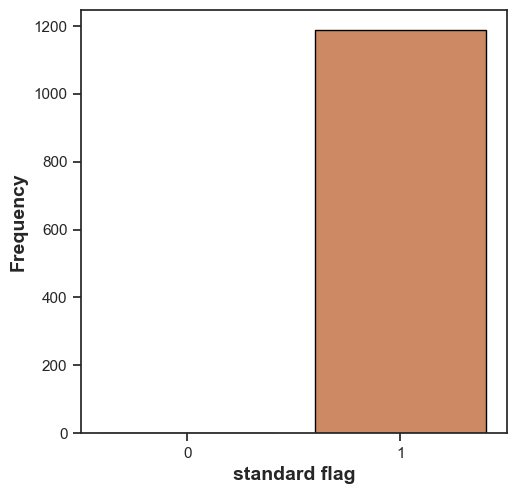

In [115]:
import seaborn as sns
sns.set(style='ticks')
import matplotlib.pyplot as plt
plt.figure(figsize=(5.5, 5.5))
sns.countplot(x='standard_flag', data=df, edgecolor='black')
plt.xlabel('standard flag', fontsize=14, fontweight='bold')
plt.ylabel('Frequency', fontsize=14, fontweight='bold')
df["standard_flag"].value_counts()

Distribution of standard flag   we notice that more than 1100 molecules are standard wich means the maority of the molecules are well-characterized compounds

In [ ]:
#Longest and shortest SMILES string 

In [130]:
# Index of the longest SMILES string
longest_smiles = max(df["canonical_smiles"], key=len)
longest_smiles_index = df.canonical_smiles[df.canonical_smiles == longest_smiles].index.tolist()
print(f"Longest SMILES: {longest_smiles}")
print(f"Contains {len(longest_smiles)} characters, index in dataframe: {longest_smiles_index[0]}.")
smiles_maxlen = len(longest_smiles)
# NBVAL_CHECK_OUTPUT

Longest SMILES: CCCCCCCCCCCCCCCC(=O)OC[C@H]1C[C@@H](OC2CC[C@@]3(C)C(=CC[C@H]4[C@@H]5CC[C@H]([C@H](C)CC[C@@H](CC)C(C)C)[C@@]5(C)CC[C@@H]43)C2)[C@H](O)[C@@H](O)[C@@H]1O
Contains 150 characters, index in dataframe: 710.


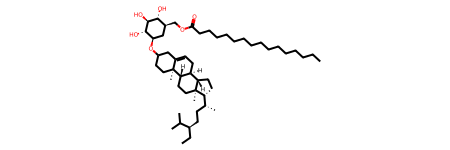

In [131]:
# Draw the molecules with the longest SMILES
longest_smiles_mol = Chem.MolFromSmiles(longest_smiles)
longest_smiles_mol

In [47]:
# Index of the shortest SMILES string
shortest_smiles = min(df["canonical_smiles"], key=len)
shortest_smiles_index = df.canonical_smiles[df.canonical_smiles == shortest_smiles].index.tolist()
print(f"Shortest SMILES: {shortest_smiles}")
print(
    f"Contains {len(shortest_smiles)} characters, index in dataframe: {shortest_smiles_index[0]}."
)
# NBVAL_CHECK_OUTPUT

Shortest SMILES: Clc1ncnc2ccccc12
Contains 16 characters, index in dataframe: 473.


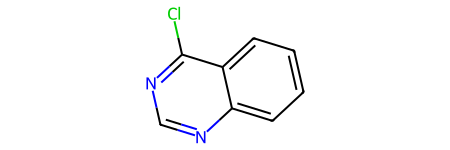

In [48]:
# Draw the molecules with the shortest SMILES
shortest_smiles_mol = Chem.MolFromSmiles(shortest_smiles)
shortest_smiles_mol

,activity_id,assay_chembl_id,assay_description,assay_type,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_units,standard_value,type,uo_units,pIC50,fingerprint_encoded,Mol2D
0,311417,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000019,assay format,COc1ccc([C@]2(C#N)CC[C@@H](C(=O)O)CC2)cc1OC1CCCC1,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,0.737746,CHEMBL511115,CHEMBL511115,2.224436e+03,0,137040,=,1,1,nM,63.00000,IC50,0,5.670000e+02,0000000000000010000000000000000000000001000000...,
1,315297,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3cccc([N+](=O)[O-]...,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,0.708966,CHEMBL74078,CHEMBL74078,6.757717e+02,1,137041,=,1,1,nM,1.00000,IC50,0,9.000000e+00,0100000000000000000000000000000000000000000000...,
2,316479,CHEMBL761828,Inhibition of human Phosphodiesterase 4D from ...,B,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3ccc4nonc4c3)n2)cc1,CHEMBL1135378,Bioorg Med Chem Lett,2002.0,0.657693,CHEMBL77826,CHEMBL77826,1.591476e+03,1,137039,=,1,1,nM,1.50000,IC50,0,1.350000e+01,0100000000000000000000000000000000000000000000...,
3,904630,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,0.689810,CHEMBL97817,CHEMBL97817,3.832657e+02,0,182108,=,1,1,nM,22.00000,IC50,0,1.980000e+02,0000000000000100000000000000010000000000000000...,
4,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,0.635806,CHEMBL319809,CHEMBL319809,1.663413e+03,0,182093,>,1,1,nM,100000.00000,IC50,0,9.000000e+05,0000000000000100000000000000010000000000000000...,
5,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,0.538626,CHEMBL330641,CHEMBL330641,2.324770e+04,0,182091,=,1,1,nM,2000.00000,IC50,0,1.800000e+04,0000000000000000000000000000000000000000000000...,
6,907426,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000357,single protein format,COc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,0.652517,CHEMBL420454,CHEMBL420454,1.371829e+03,0,182100,=,1,1,nM,140.00000,IC50,0,1.260000e+03,0000000000000100000000000000010000000000000000...,
7,907873,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000019,assay format,O=C(O)c1ccc(-c2cc3cccnc3c(-c3cccc(Cl)c3)n2)cc1,CHEMBL1133705,J Med Chem,2000.0,0.800037,CHEMBL161115,CHEMBL161115,1.215066e+02,0,313941,=,1,1,nM,2.00000,IC50,0,1.800000e+01,0100000000000000000000000000000000000000000000...,
8,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,0.687372,CHEMBL95979,CHEMBL95979,2.614568e+01,0,182109,=,1,1,nM,3000.00000,IC50,0,2.700000e+04,0000000000000110000000000000010000000000000000...,
9,908917,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000019,assay format,O=S(=O)(Oc1cc2cccnc2c(-c2cccc(Cl)c2)n1)C(F)(F)F,CHEMBL1133705,J Med Chem,2000.0,0.768035,CHEMBL161714,CHEMBL161714,1.664945e+03,0,313954,=,1,1,nM,48.00000,IC50,0,4.320000e+02,0100000000000000000000000000000000000000000000...,

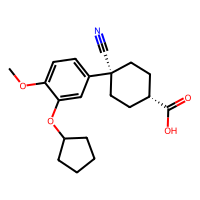
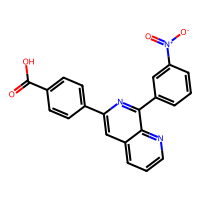
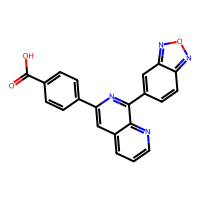
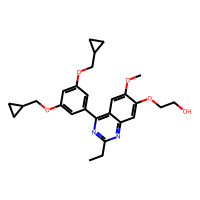
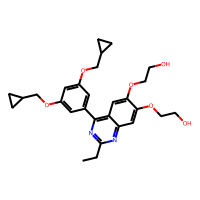
...
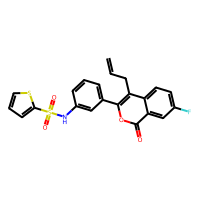
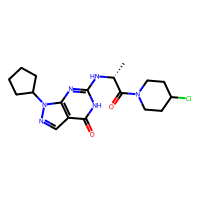
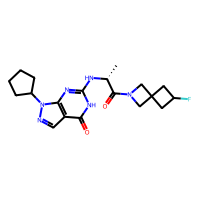
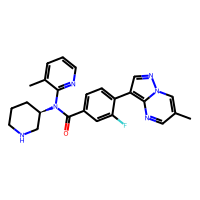
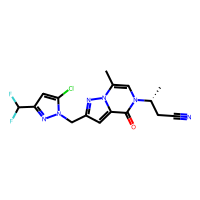

In [133]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import PandasTools
from rdkit.Chem import AllChem
df2=df
PandasTools.AddMoleculeColumnToFrame(df2, smilesCol="canonical_smiles", molCol="Mol2D")
Draw.MolsToGridImage(list(df2.Mol2D[0:10]), legends=list(df2.molecule_chembl_id	[0:20]), molsPerRow=5)
df2

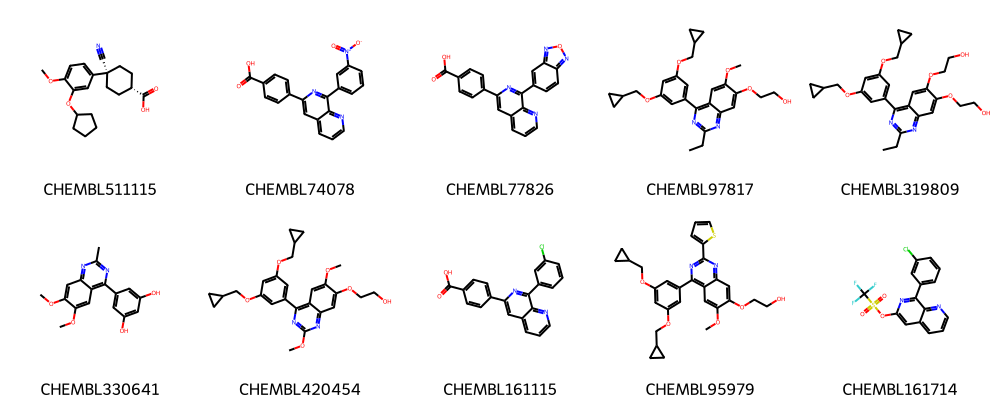

In [35]:
# Using PandasTools and the respective Draw method
PandasTools.AddMoleculeColumnToFrame(df2, smilesCol="canonical_smiles", molCol="Mol2D")
Draw.MolsToGridImage(list(df2.Mol2D[0:10]), legends=list(df2.molecule_chembl_id[0:20]), molsPerRow=5)

In [ ]:
#assay_type

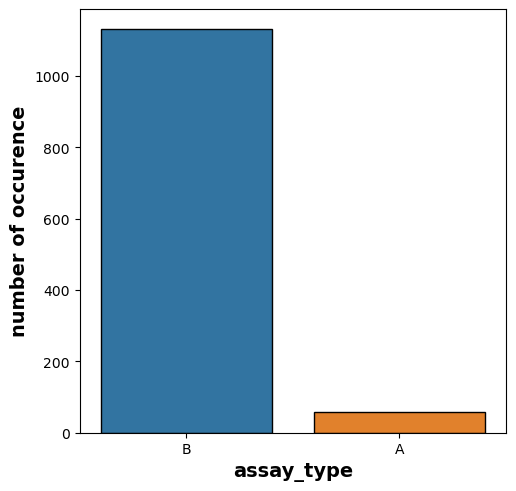

In [49]:
plt.figure(figsize=(5.5, 5.5))
sns.countplot(x='assay_type', data=df, edgecolor='black')
plt.xlabel('assay_type', fontsize=14, fontweight='bold')
plt.ylabel('number of occurence', fontsize=14, fontweight='bold')

More than 1000 molecules are tested with assay type B which is the binding of a compound to its molecular target.It's influenced by a number of factors, including the chemical properties of the compound, the structure and dynamics of the target molecule.


In [157]:
df["assay_type"].value_counts()

B    1131
A      58
Name: assay_type, dtype: int64

In [155]:
dfEnco

,activity_id,assay_chembl_id,assay_description,assay_type,bao_format,bao_label,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_units,standard_value,type,uo_units,pIC50
0,311417,141,86,1,0,0,3,2,2002.0,0.737746,1062,1062,2.224436e+03,0,137040,1,1,1,0,63.00000,0,0,5.670000e+02
1,315297,141,86,1,0,0,3,2,2002.0,0.708966,1171,1169,6.757717e+02,1,137041,1,1,1,0,1.00000,0,0,9.000000e+00
2,316479,141,86,1,0,0,3,2,2002.0,0.657693,1172,1170,1.591476e+03,1,137039,1,1,1,0,1.50000,0,0,1.350000e+01
3,904630,138,8,1,3,2,0,2,1998.0,0.689810,1183,1181,3.832657e+02,0,182108,1,1,1,0,22.00000,0,0,1.980000e+02
4,904635,138,8,1,3,2,0,2,1998.0,0.635806,324,325,1.663413e+03,0,182093,2,1,1,0,100000.00000,0,0,9.000000e+05
5,907422,138,8,1,3,2,0,2,1998.0,0.538626,343,344,2.324770e+04,0,182091,1,1,1,0,2000.00000,0,0,1.800000e+04
6,907426,138,8,1,3,2,0,2,1998.0,0.652517,633,633,1.371829e+03,0,182100,1,1,1,0,140.00000,0,0,1.260000e+03
7,907873,140,125,1,0,0,2,4,2000.0,0.800037,47,47,1.215066e+02,0,313941,1,1,1,0,2.00000,0,0,1.800000e+01
8,908437,138,8,1,3,2,0,2,1998.0,0.687372,1177,1175,2.614568e+01,0,182109,1,1,1,0,3000.00000,0,0,2.700000e+04
9,908917,140,125,1,0,0,2,4,2000.0,0.768035,50,50,1.664945e+03,0,313954,1,1,1,0,48.00000,0,0,4.320000e+02


# Outliers 

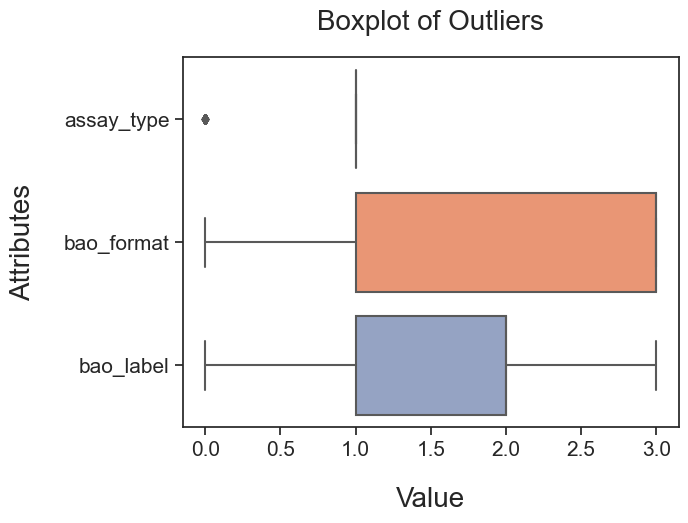

In [159]:
column=['assay_type','bao_format', 'bao_label']
ax = sns.boxplot(data = dfEnco[column], orient = "h", palette = "Set2")
#add labels
ax.set_xlabel("Value", fontsize = 20, labelpad = 20)
ax.set_ylabel("Attributes", fontsize = 20, labelpad = 20)
ax.set_title("Boxplot of Outliers", fontsize = 20,pad = 20)
#edit ticks
ax.tick_params(which = "both", labelsize = 15)

after visualizing the outliers , we notice that there are outliers in assay_type which are related to the assay type A which is test of absorption, distribution, metabolism, excretion, and toxicity) assays, which measure various properties related to the pharmacokinetics and safety of a compound and they are important for drug discovery.

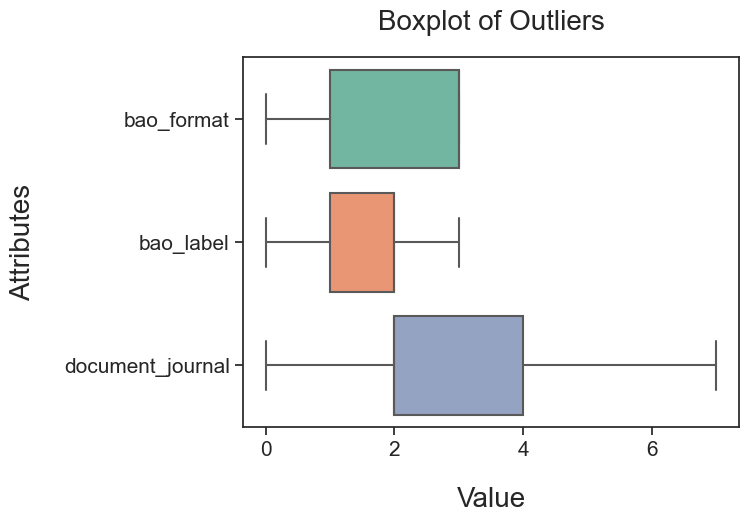

In [160]:
column=[ 'bao_format', 'bao_label' ,'document_journal' ]
ax = sns.boxplot(data = dfEnco[column], orient = "h", palette = "Set2")
#add labels
ax.set_xlabel("Value", fontsize = 20, labelpad = 20)
ax.set_ylabel("Attributes", fontsize = 20, labelpad = 20)
ax.set_title("Boxplot of Outliers", fontsize = 20,pad = 20)
#edit ticks
ax.tick_params(which = "both", labelsize = 15)

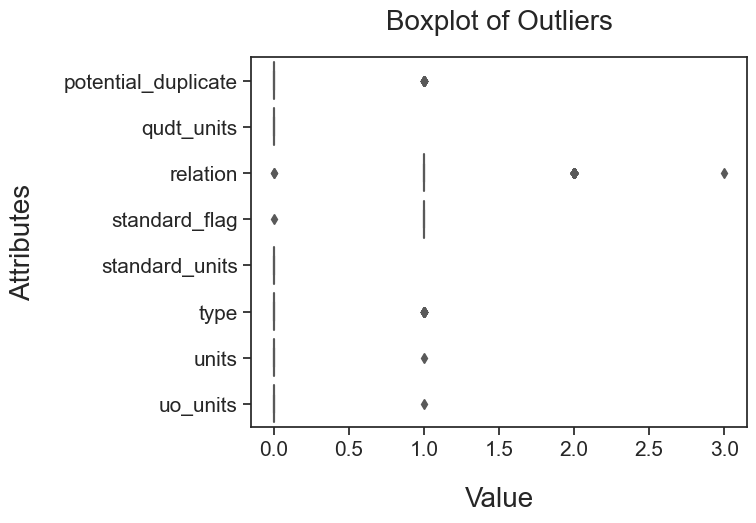

In [179]:
column=['potential_duplicate',
       'qudt_units', 'relation',  'standard_flag',
        'standard_units', 'type','units', 'uo_units']
ax = sns.boxplot(data = dfEnco[column], orient = "h", palette = "Set2")
#add labels
ax.set_xlabel("Value", fontsize = 20, labelpad = 20)
ax.set_ylabel("Attributes", fontsize = 20, labelpad = 20)
ax.set_title("Boxplot of Outliers", fontsize = 20,pad = 20)
#edit ticks
ax.tick_params(which = "both", labelsize = 15)

after visualization we noticed the absence of outliers.

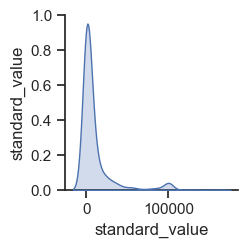

In [161]:
# Select the relevant columns for EDA
cols = ['standard_value']
# Plot pairwise scatterplots for the relevant columns
sns.pairplot(dfEnco[cols], diag_kind='kde')
plt.show()
# Define a function to detect outliers using the IQR method
def detect_outliers_iqr(data, threshold=1.5):
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    return ((data < Q1 - threshold*IQR) | (data > Q3 + threshold*IQR))

# Apply the detect_outliers_iqr function to the relevant columns in the DataFrame
outlier_cols =  ['standard_value']
outliers = dfEnco[outlier_cols][detect_outliers_iqr(dfEnco[outlier_cols])]

For the column standard_value its seems that we have outliers for values 100000 but its possible to have this high value >10000. It explains the concentration of a compound required to achieve a certain level of biological activity.

<div style='font-size:100%;'>
    <a id='clean'></a>
    <h1 style='color: black; font-weight: bold; font-family: Cascadia code;'>
        <center> Properties ⬇️ </center>
    </h1>
</div>

In [106]:
# Loop through rows and get number of atoms for each molecule
num_atoms_list = []
for smiles in df_['canonical_smiles']:
    # Create an RDKit molecule object from the SMILES string
    mol = Chem.MolFromSmiles(smiles)
    # Get the number of atoms in the molecule
    num_atoms = mol.GetNumAtoms()
    # Add the number of atoms to the list
    num_atoms_list.append(num_atoms)
# Add the num_atoms_list as a new column to the DataFrame
df_['num_atoms'] = num_atoms_list

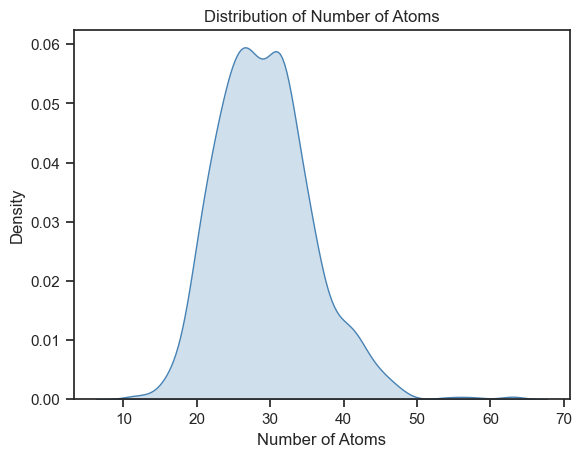

In [170]:
sns.kdeplot(df['num_atoms'], shade=True, color='steelblue')
plt.xlabel('Number of Atoms')
plt.ylabel('Density')
plt.title('Distribution of Number of Atoms')
plt.show()


the number of atoms provides important information about the size and complexity of the molecule, which in turn can influence its physical and chemical properties.

we can see from the list that the most common size of molecules in the set is 25-32 atoms, with the number of molecules decreasing as the size gets larger or smaller. 
molecule with 30 atoms is generally considered to be a small to medium-sized molecule

In [105]:
mols = [Chem.MolFromSmiles(smiles) for smiles in df_ ['canonical_smiles']]
df_['num_rings'] = [Descriptors.RingCount(mol) for mol in mols]

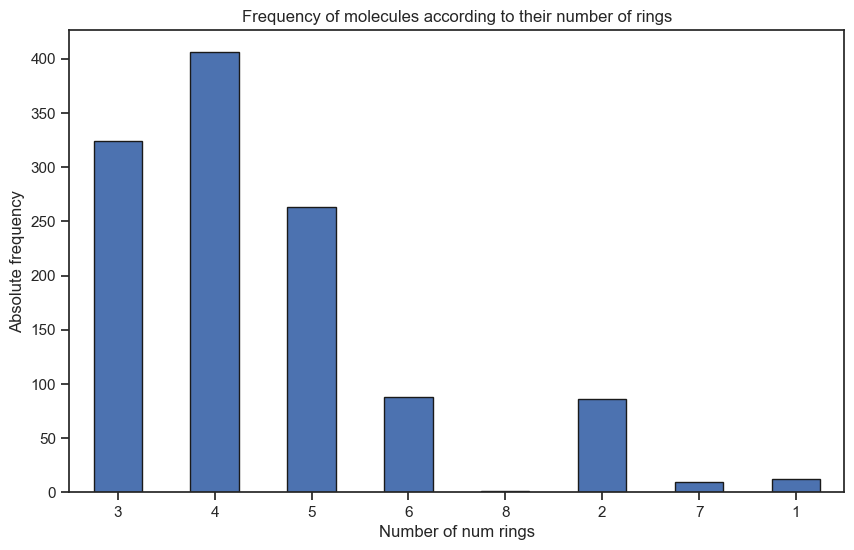

In [165]:
df['num_rings'].value_counts(sort=False).plot.bar(figsize=(10,6), 
                                                     title="Frequency of molecules according to their number of rings", 
                                                     xlabel='Number of num rings',
                                                     ylabel='Absolute frequency',
                                                     rot=0,
                                                     edgecolor='k')
plt.show()

Most of molecules in our dataset contains between 3 to 5 rings. With this structure its considered as a polycyclic molecule with a complex and potentially interesting structure.

# Add Bioactivity Class for standard_value

In [107]:
df_

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,target_pref_name,target_tax_id,type,uo_units,standard_values,pIC50,num_rings,num_atoms
0,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000,5,36
1,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,2000.00,5.698970,3,23
2,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,3000.00,5.522879,6,37
3,908930,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '21.44', 'le': '0.39', 'lle': '2.18', ...",CHEMBL351915,CHEMBL351915,5.39,0,313946,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,4100.00,5.387216,3,19
4,912437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.71', 'le': '0.27', 'lle': '1.04', ...",CHEMBL95715,CHEMBL95715,6.19,0,182096,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,650.00,6.187087,5,31
5,913791,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.97', 'le': '0.26', 'lle': '1.26', ...",CHEMBL318444,CHEMBL318444,6.07,0,182094,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,850.00,6.070581,5,32
6,917645,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '12.39', 'le': '0.24', 'lle': '0.78', ...",CHEMBL99101,CHEMBL99101,6.16,0,182098,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,700.00,6.154902,5,35
7,921217,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL99470,CHEMBL99470,NaN,0,182097,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000,6,38
8,923690,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.50', 'le': '0.27', 'lle': '0.90', ...",CHEMBL96034,CHEMBL96034,6.10,0,182110,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,800.00,6.096910,5,31
9,923694,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.03', 'le': '0.25', 'lle': '2.59', ...",CHEMBL97785,CHEMBL97785,6.64,0,182103,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000

In [108]:
Class = []
for i in df_.standard_values:
  if float(i) >= 10000.0:
    Class.append("inactive")
  elif float(i) <= 1000.0:
    Class.append("active")
  elif float(i) > 1000.0 and float(i) < 10000.0:
    Class.append("intermediate")

In [109]:
bioactivity_class = pd.Series(Class, name='Class')
df= pd.concat([df_, bioactivity_class], axis=1, join='inner')

In [110]:
df

,activity_id,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,parent_molecule_chembl_id,pchembl_value,potential_duplicate,record_id,relation,src_id,standard_flag,standard_type,standard_units,target_pref_name,target_tax_id,type,uo_units,standard_values,pIC50,num_rings,num_atoms,Class
0,904635,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL319809,CHEMBL319809,NaN,0,182093,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000,5,36,inactive
1,907422,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '18.25', 'le': '0.34', 'lle': '2.67', ...",CHEMBL330641,CHEMBL330641,5.70,0,182091,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,2000.00,5.698970,3,23,intermediate
2,908437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '10.65', 'le': '0.20', 'lle': '-0.46',...",CHEMBL95979,CHEMBL95979,5.52,0,182109,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,3000.00,5.522879,6,37,intermediate
3,908930,CHEMBL761827,Inhibitory activity against Phosphodiesterase ...,B,BAO_0000190,BAO_0000019,assay format,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL1133705,J Med Chem,2000.0,"{'bei': '21.44', 'le': '0.39', 'lle': '2.18', ...",CHEMBL351915,CHEMBL351915,5.39,0,313946,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,4100.00,5.387216,3,19,intermediate
4,912437,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.71', 'le': '0.27', 'lle': '1.04', ...",CHEMBL95715,CHEMBL95715,6.19,0,182096,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,650.00,6.187087,5,31,active
5,913791,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.97', 'le': '0.26', 'lle': '1.26', ...",CHEMBL318444,CHEMBL318444,6.07,0,182094,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,850.00,6.070581,5,32,active
6,917645,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '12.39', 'le': '0.24', 'lle': '0.78', ...",CHEMBL99101,CHEMBL99101,6.16,0,182098,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,700.00,6.154902,5,35,active
7,921217,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,NaN,CHEMBL99470,CHEMBL99470,NaN,0,182097,>,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,100000.00,4.000000,6,38,inactive
8,923690,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '14.50', 'le': '0.27', 'lle': '0.90', ...",CHEMBL96034,CHEMBL96034,6.10,0,182110,=,1,1,IC50,nM,Phosphodiesterase 4D,9606,IC50,UO_0000065,800.00,6.096910,5,31,active
9,923694,CHEMBL761825,Evaluated for its ability to inhibit PDE4D.,B,BAO_0000190,BAO_0000357,single protein format,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL1130634,Bioorg Med Chem Lett,1998.0,"{'bei': '13.03', 'le': '0.25', 'lle': '2.59', ..."

Text(0, 0.5, 'Frequency')

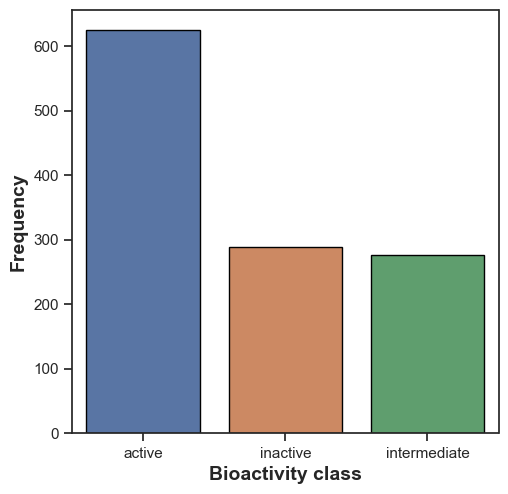

In [177]:
import seaborn as sns
sns.set(style='ticks')
import matplotlib.pyplot as plt
plt.figure(figsize=(5.5, 5.5))
sns.countplot(x='Class', data=df, edgecolor='black')
plt.xlabel('Bioactivity class', fontsize=14, fontweight='bold')
plt.ylabel('Frequency', fontsize=14, fontweight='bold')


# Lipinski

In [111]:
def lipinski(smiles, verbose=False):

    moldata= []
    for elem in smiles:
        mol=Chem.MolFromSmiles(elem) 
        moldata.append(mol)
       
    baseData= np.arange(1,1)
    i=0  
    for mol in moldata:         
        desc_MolWt = Descriptors.MolWt(mol)
        desc_MolLogP = Descriptors.MolLogP(mol)
        desc_NumHDonors = Lipinski.NumHDonors(mol)
        desc_NumHAcceptors = Lipinski.NumHAcceptors(mol)
        desc_psa = Chem.rdMolDescriptors.CalcTPSA(mol)
        desc_rotb = Chem.rdMolDescriptors.CalcNumRotatableBonds(mol)
        desc_ValEl = Descriptors.NumValenceElectrons(mol)
        desc_aliphCarb = Descriptors.NumAliphaticCarbocycles(mol) 
        desc_NumHeter = Descriptors.NumHeteroatoms(mol)
        #desc_Rings= Descriptors.RingCount(mol)

    
        row = np.array([desc_MolWt,desc_MolLogP,desc_NumHDonors,desc_NumHAcceptors,desc_psa,
                       desc_rotb,desc_ValEl,desc_aliphCarb,desc_NumHeter
                        #,desc_Rings
                       ])   
        if(i==0):
            baseData=row
        else:
            baseData=np.vstack([baseData, row])
        i=i+1      
    
    columnNames=["MW","LogP","NumHDonors","NumHAcceptors","PolarSurface","Rotatable","ValenceElect","NumAliphaticCarboc",
                "NumHeteroat"]   
    descriptors = pd.DataFrame(data=baseData,columns=columnNames)
    
    return descriptors

In [112]:
dfInsert = df[['molecule_chembl_id','canonical_smiles','standard_values','num_rings','num_atoms','pIC50','Class']]
dfLipinski = lipinski(df.canonical_smiles)
dfProp= pd.concat([dfInsert,dfLipinski],axis=1,join="inner")
dfProp

,molecule_chembl_id,canonical_smiles,standard_values,num_rings,num_atoms,pIC50,Class,MW,LogP,NumHDonors,NumHAcceptors,PolarSurface,Rotatable,ValenceElect,NumAliphaticCarboc,NumHeteroat
0,CHEMBL319809,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,100000.00,5,36,4.000000,inactive,494.588,4.17900,2.0,8.0,103.16,14.0,192.0,2.0,8.0
1,CHEMBL330641,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,2000.00,3,23,5.698970,intermediate,312.325,3.03362,2.0,6.0,84.70,3.0,118.0,0.0,6.0
2,CHEMBL95979,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,3000.00,6,37,5.522879,intermediate,518.635,5.98260,1.0,8.0,82.93,12.0,192.0,2.0,8.0
3,CHEMBL351915,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,4100.00,3,19,5.387216,intermediate,251.245,3.20500,0.0,4.0,68.92,2.0,92.0,0.0,5.0
4,CHEMBL95715,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,650.00,5,31,6.187087,active,420.509,5.15100,1.0,6.0,73.70,9.0,162.0,2.0,6.0
5,CHEMBL318444,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,850.00,5,32,6.070581,active,434.536,4.80790,1.0,6.0,73.70,11.0,168.0,2.0,6.0
6,CHEMBL99101,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,700.00,5,35,6.154902,active,496.629,5.36610,1.0,8.0,82.93,13.0,186.0,2.0,8.0
7,CHEMBL99470,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,100000.00,6,38,4.000000,inactive,510.634,7.02440,0.0,6.0,62.70,12.0,196.0,2.0,6.0
8,CHEMBL96034,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,800.00,5,31,6.096910,active,420.509,5.20002,0.0,6.0,62.70,9.0,162.0,2.0,6.0
9,CHEMBL97785,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,230.00,5,37,6.638272,active,509.603,4.04840,3.0,9.0,115.19,15.0,198.0,2.0,9.0


In [113]:
dfProp.to_csv('VersionBrute3.csv', index=False)

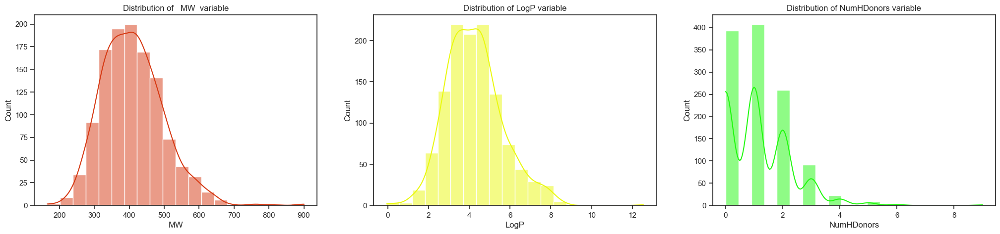

In [234]:
fig, axes = plt.subplots(1, 3, figsize = (25, 5))
ax = axes.flatten()
sns.histplot(ax = axes[0], x = dfProp["MW"], bins = 20, kde = True, color = "#D63913").set(title = "Distribution of   MW  variable");
sns.histplot(ax = axes[1], x = dfProp["LogP"], bins = 20, kde = True, color = "#EAF90E").set(title = "Distribution of LogP variable");
sns.histplot(ax = axes[2], x = dfProp["NumHDonors"], bins = 20, kde = True, color = "#20F90E").set(title = "Distribution of NumHDonors variable");

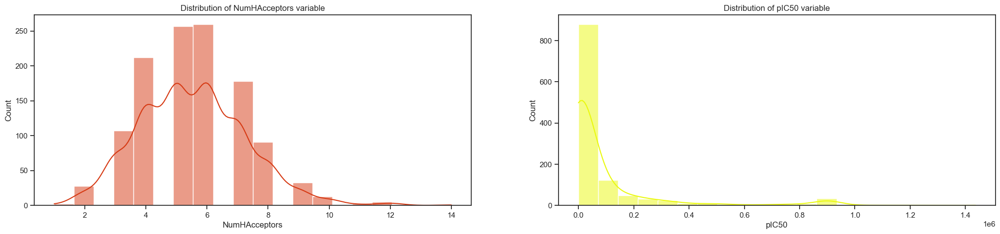

In [235]:
fig, axes = plt.subplots(1, 2, figsize = (25, 5))
ax = axes.flatten()
sns.histplot(ax = axes[0], x = dfProp["NumHAcceptors"], bins = 20, kde = True, color = "#D63913").set(title = "Distribution of NumHAcceptors variable");
sns.histplot(ax = axes[1], x = dfProp["pIC50"], bins = 20, kde = True, color = "#EAF90E").set(title = "Distribution of pIC50 variable");

with these visualisations, we can see the destribution of the data for the different properties and the values they can take.

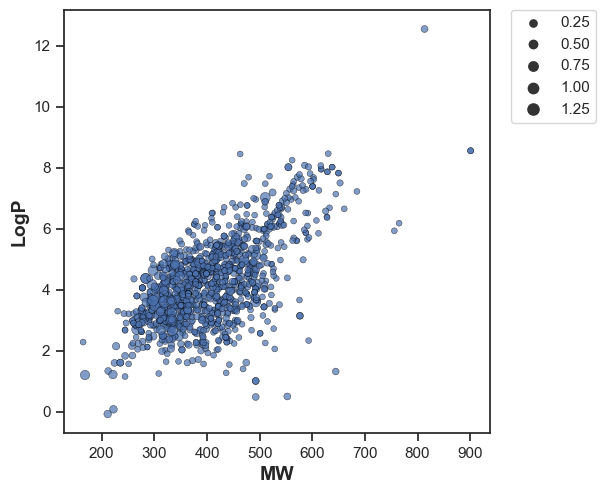

In [195]:
plt.figure(figsize=(5.5, 5.5))

sns.scatterplot(x='MW', y='LogP', data=dfProperty, size='pIC50', edgecolor='black', alpha=0.7)

plt.xlabel('MW', fontsize=14, fontweight='bold')
plt.ylabel('LogP', fontsize=14, fontweight='bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)

Both features LogP and MW are have strong relation and they are correlated positively 

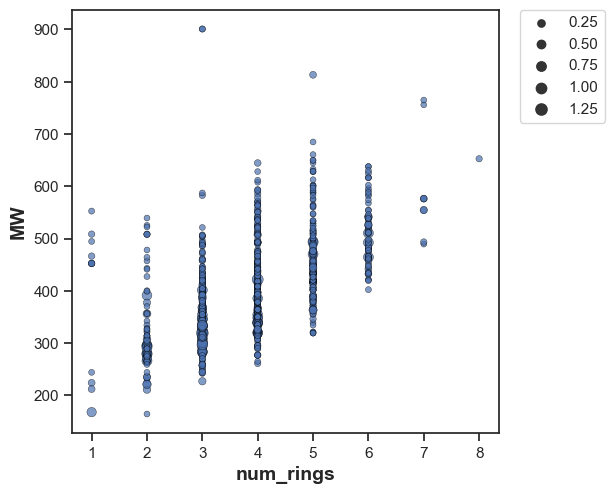

In [228]:
plt.figure(figsize=(5.5, 5.5))

sns.scatterplot(x='num_rings', y='MW', data=dfProp, size='pIC50', edgecolor='black', alpha=0.7)

plt.xlabel('num_rings', fontsize=14, fontweight='bold')
plt.ylabel('MW', fontsize=14, fontweight='bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)

molecules with more rings tend to have higher molecular weights, as the rings contribute to the overall mass of the molecule

Text(0, 0.5, 'pIC50 value')

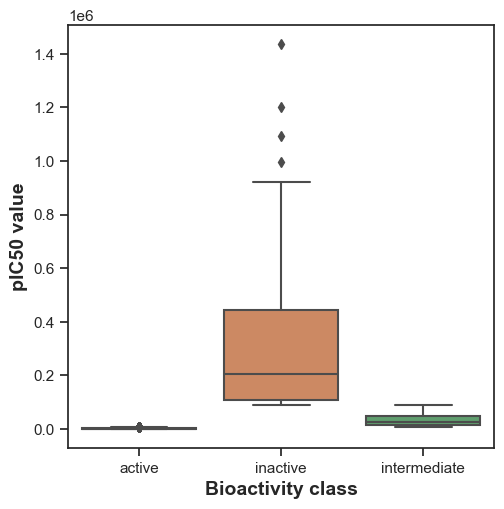

In [239]:
plt.figure(figsize=(5.5, 5.5))

sns.boxplot(x = 'Class', y = 'pIC50', data = dfProp)

plt.xlabel('Bioactivity class', fontsize=14, fontweight='bold')
plt.ylabel('pIC50 value', fontsize=14, fontweight='bold')


Text(0, 0.5, 'MW')

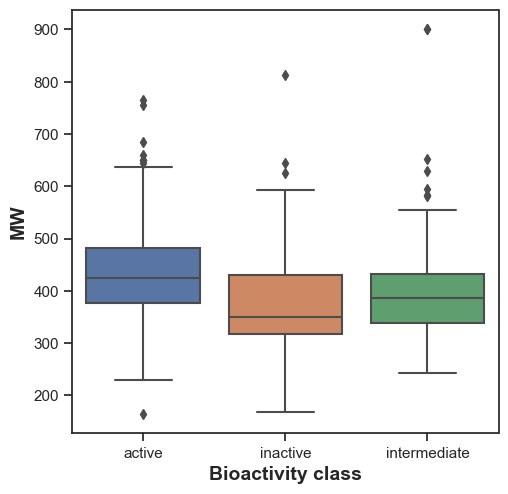

In [238]:
plt.figure(figsize=(5.5, 5.5))

sns.boxplot(x = 'Class', y = 'MW', data = dfProp)
plt.xlabel('Bioactivity class', fontsize=14, fontweight='bold')
plt.ylabel('MW', fontsize=14, fontweight='bold')

=> According to boxplots, Data is not Balanced.It needs to be balanced before fitting model

In [241]:
#Import after imputation
dfProp= pd.read_csv('DfProp.csv')

In [ ]:
#Balance Database

In [ ]:
pip install imblearn

In [43]:
# Import necessary libraries
import pandas as pd
from imblearn.over_sampling import RandomOverSampler

# Load the dataset
dftest=df

# Separate features and target
X = dftest.drop("Class", axis=1)
y = dftest["Class"]

# Instantiate the RandomOverSampler
ros = RandomOverSampler(random_state=0)

# Resample the data
X_resampled, y_resampled = ros.fit_resample(X, y)

# Convert the resampled data to a new DataFrame
dfBalanced = pd.DataFrame(X_resampled, columns=X.columns)
dfBalanced["Class"] = y_resampled

# Verify the class distribution of the resampled data
print(dfBalanced["Class"].value_counts())

active          625
inactive        625
intermediate    625
Name: Class, dtype: int64


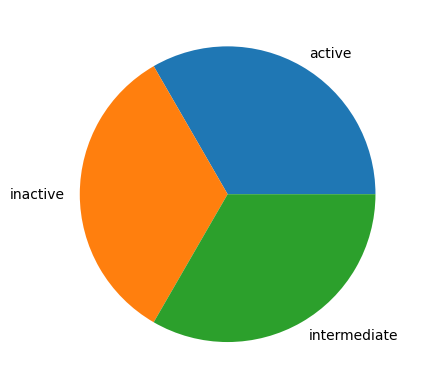

In [52]:
dfbao = pd.DataFrame(dfBalanced['Class'])
value_counts = dfBalanced['Class'].value_counts()
new_df = pd.DataFrame({'Class': value_counts.index, 'count': value_counts.values})
y = dfBalanced['Class'].value_counts()
mylabels = new_df['Class']
plt.pie(y, labels = mylabels)
plt.show() 

In [71]:
#export 
dfProp.to_csv('DfProperty.csv', index=False)

In [72]:
#Import after imputation
dfProp= pd.read_csv('DfProperty.csv')

In [114]:
selection = ['canonical_smiles','molecule_chembl_id']
df_selection = dfProp[selection]
df_selection.to_csv('molecule.smi', sep='\t', index=False, header=False)

In [115]:
df_selection

,canonical_smiles,molecule_chembl_id
0,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c...,CHEMBL319809
1,COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC,CHEMBL330641
2,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3ccc...,CHEMBL95979
3,O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1,CHEMBL351915
4,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL95715
5,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2ccc(OCCO)...,CHEMBL318444
6,CCSc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(...,CHEMBL99101
7,CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O...,CHEMBL99470
8,COc1cc2nc(C)nc(-c3cc(OCC4CC4)cc(OCC4CC4)c3)c2c...,CHEMBL96034
9,COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(NCCCO)...,CHEMBL97785


In [116]:
! cat molecule.smi | head -5

CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OCCO)c(OCCO)cc2n1	CHEMBL319809
COc1cc2nc(C)nc(-c3cc(O)cc(O)c3)c2cc1OC	CHEMBL330641
COc1cc2c(-c3cc(OCC4CC4)cc(OCC4CC4)c3)nc(-c3cccs3)nc2cc1OCCO	CHEMBL95979
O=[N+]([O-])c1cccc(-c2nccc3cccnc23)c1	CHEMBL351915
CCc1nc(-c2cc(OCC3CC3)cc(OCC3CC3)c2)c2cc(OC)c(O)cc2n1	CHEMBL95715


In [119]:
!C:/wget/wget.exe https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
!C:/wget/wget.exe https://github.com/dataprofessor/bioinformatics/raw/master/padel.sh

--2023-04-24 22:13:30--  https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip [following]
--2023-04-24 22:13:31--  https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25768637 (25M) [application/zip]
Saving to: 'padel.zip'

     0K .......... .......... .......... .......... ..........  0%  662K 38s
    50K .......... .......... .......... .......... ..........  0% 1010K 31s
   100K .......... .......... ........

--2023-04-24 22:16:05--  https://github.com/dataprofessor/bioinformatics/raw/master/padel.sh
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.sh [following]
--2023-04-24 22:16:05--  https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.sh
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 231 [text/plain]
Saving to: 'padel.sh'

     0K                                                       100% 4.16M=0s

2023-04-24 22:16:06 (4.16 MB/s) - 'padel.sh' saved [231/231]



In [120]:
! unzip padel.zip

Archive:  padel.zip
   creating: PaDEL-Descriptor/     
  inflating: __MACOSX/._PaDEL-Descriptor  
  inflating: PaDEL-Descriptor/MACCSFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._MACCSFingerprinter.xml  
  inflating: PaDEL-Descriptor/AtomPairs2DFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._AtomPairs2DFingerprinter.xml  
  inflating: PaDEL-Descriptor/EStateFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._EStateFingerprinter.xml  
  inflating: PaDEL-Descriptor/Fingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._Fingerprinter.xml  
  inflating: PaDEL-Descriptor/.DS_Store  
  inflating: __MACOSX/PaDEL-Descriptor/._.DS_Store  
   creating: PaDEL-Descriptor/license/
  inflating: __MACOSX/PaDEL-Descriptor/._license  
  inflating: PaDEL-Descriptor/KlekotaRothFingerprintCount.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._KlekotaRothFingerprintCount.xml  
  inflating: PaDEL-Descriptor/config  
  inflating: __MACOSX/PaDEL-Descriptor/._config  


  inflating: PaDEL-Descriptor/lib/guava-17.0.jar  
  inflating: __MACOSX/PaDEL-Descriptor/lib/._guava-17.0.jar  
  inflating: PaDEL-Descriptor/lib/ambit2-smarts-2.4.7-SNAPSHOT(4).jar  
  inflating: __MACOSX/PaDEL-Descriptor/lib/._ambit2-smarts-2.4.7-SNAPSHOT(4).jar  
  inflating: PaDEL-Descriptor/lib/libPaDEL-Jobs(5).jar  
  inflating: __MACOSX/PaDEL-Descriptor/lib/._libPaDEL-Jobs(5).jar  


## **Calculate fingerprint descriptors**


In [121]:
! cat padel.sh

java -Xms1G -Xmx1G -Djava.awt.headless=true -jar ./PaDEL-Descriptor/PaDEL-Descriptor.jar -removesalt -standardizenitro -fingerprints -descriptortypes ./PaDEL-Descriptor/PubchemFingerprinter.xml -dir ./ -file descriptors_output.csv


In [122]:
! bash padel.sh

Processing CHEMBL319809 in molecule.smi (1/766). 

Apr 24, 2023 10:17:41 PM libpadeldescriptor.libPaDELDescriptorMaster hasNextJob
SEVERE: NTUSER.DAT
java.io.FileNotFoundException: .\NTUSER.DAT (The process cannot access the file because it is being used by another process)
	at java.io.FileInputStream.open0(Native Method)
	at java.io.FileInputStream.open(Unknown Source)
	at java.io.FileInputStream.<init>(Unknown Source)
	at libpadeldescriptor.IteratingPaDELReader.<init>(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.AddJobsToQueue(Unknown Source)
	at libpadeljobs.Master.DoWork(Master.java:40)
	at padeldescriptor.PaDELDescriptorApp.StartCmd(Unknown Source)
	at padeldescriptor.PaDELDescriptorApp.launchCommandLine(Unknown Sourc


Processing CHEMBL95979 in molecule.smi (3/766). 
Processing CHEMBL330641 in molecule.smi (2/766). 
Processing CHEMBL351915 in molecule.smi (4/766). 
Processing CHEMBL95715 in molecule.smi (5/766). 
Processing CHEMBL318444 in molecule.smi (6/766). 
Processing CHEMBL99101 in molecule.smi (7/766). 
Processing CHEMBL99470 in molecule.smi (8/766). 
Processing CHEMBL96034 in molecule.smi (9/766). 
Processing CHEMBL97785 in molecule.smi (10/766). Average speed: 3.04 s/mol.
Processing CHEMBL418785 in molecule.smi (11/766). Average speed: 1.68 s/mol.
Processing CHEMBL98730 in molecule.smi (12/766). Average speed: 1.24 s/mol.
Processing CHEMBL97866 in molecule.smi (13/766). Average speed: 0.76 s/mol.
Processing CHEMBL345812 in molecule.smi (14/766). Average speed: 0.76 s/mol.
Processing CHEMBL161602 in molecule.smi (15/766). Average speed: 0.55 s/mol.
Processing CHEMBL420999 in molecule.smi (16/766). Average speed: 0.56 s/mol.
Processing CHEMBL97213 in molecule.smi (17/766). Average speed: 0.49


	at padeldescriptor.PaDELDescriptorApp.launchCommandLine(Unknown Source)
	at padeldescriptor.PaDELDescriptorApp.main(Unknown Source)

Apr 24, 2023 10:17:41 PM libpadeldescriptor.libPaDELDescriptorMaster hasNextJob
SEVERE: ntuser.dat.LOG2
java.io.FileNotFoundException: .\ntuser.dat.LOG2 (The process cannot access the file because it is being used by another process)
	at java.io.FileInputStream.open0(Native Method)
	at java.io.FileInputStream.open(Unknown Source)
	at java.io.FileInputStream.<init>(Unknown Source)
	at libpadeldescriptor.IteratingPaDELReader.<init>(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescriptorMaster.hasNextJob(Unknown Source)
	at libpadeldescriptor.libPaDELDescripto

Processing CHEMBL466068 in molecule.smi (119/766). Average speed: 0.10 s/mol.
Processing CHEMBL466481 in molecule.smi (120/766). Average speed: 0.10 s/mol.
Processing CHEMBL446547 in molecule.smi (121/766). Average speed: 0.10 s/mol.
Processing CHEMBL507064 in molecule.smi (122/766). Average speed: 0.10 s/mol.
Processing CHEMBL462517 in molecule.smi (123/766). Average speed: 0.10 s/mol.
Processing CHEMBL462448 in molecule.smi (124/766). Average speed: 0.10 s/mol.
Processing CHEMBL514277 in molecule.smi (126/766). Average speed: 0.10 s/mol.
Processing CHEMBL462518 in molecule.smi (125/766). Average speed: 0.10 s/mol.
Processing CHEMBL455962 in molecule.smi (127/766). Average speed: 0.10 s/mol.
Processing CHEMBL509969 in molecule.smi (129/766). Average speed: 0.10 s/mol.
Processing CHEMBL456170 in molecule.smi (128/766). Average speed: 0.10 s/mol.
Processing CHEMBL447757 in molecule.smi (130/766). Average speed: 0.10 s/mol.
Processing CHEMBL445832 in molecule.smi (131/766). Average speed

## **Preparing the X and Y Data Matrices**

In [123]:
df_x = pd.read_csv('descriptors_output.csv')

In [125]:
df_x.to_csv('descriptors_output2.csv', index=False)

In [126]:
df_x = df_x.drop(columns=['Name'])
df_x

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,...,PubchemFP859,PubchemFP860,PubchemFP861,PubchemFP862,PubchemFP863,PubchemFP864,PubchemFP865,PubchemFP866,PubchemFP867,PubchemFP868,PubchemFP869,PubchemFP870,PubchemFP871,PubchemFP872,PubchemFP873,PubchemFP874,PubchemFP875,PubchemFP876,PubchemFP877,PubchemFP878,PubchemFP879,PubchemFP880
0,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,1,1,1,1,0,0,0,0,0,1,1,1,1,1,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [128]:
df_class=dfProp['Class']

In [129]:
df_y = dfProp['pIC50']

In [131]:
dataset = pd.concat([df_x,df_y,df_class], axis=1)
dataset

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,...,PubchemFP861,PubchemFP862,PubchemFP863,PubchemFP864,PubchemFP865,PubchemFP866,PubchemFP867,PubchemFP868,PubchemFP869,PubchemFP870,PubchemFP871,PubchemFP872,PubchemFP873,PubchemFP874,PubchemFP875,PubchemFP876,PubchemFP877,PubchemFP878,PubchemFP879,PubchemFP880,pIC50,Class
0,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.000000,inactive
1,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5.698970,intermediate
2,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5.522879,intermediate
3,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5.387216,intermediate
4,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.187087,active
5,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.070581,active
6,1,1,1,1,0,0,0,0,0,1,1,1,1,1,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.154902,active
7,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.000000,inactive
8,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.096910,active
9,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.638272,active


In [132]:
df_2class = dataset[dataset['Class'] != 'intermediate']
df_2class

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,...,PubchemFP861,PubchemFP862,PubchemFP863,PubchemFP864,PubchemFP865,PubchemFP866,PubchemFP867,PubchemFP868,PubchemFP869,PubchemFP870,PubchemFP871,PubchemFP872,PubchemFP873,PubchemFP874,PubchemFP875,PubchemFP876,PubchemFP877,PubchemFP878,PubchemFP879,PubchemFP880,pIC50,Class
0,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.000000,inactive
4,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.187087,active
5,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.070581,active
6,1,1,1,1,0,0,0,0,0,1,1,1,1,1,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.154902,active
7,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.000000,inactive
8,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.096910,active
9,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.638272,active
10,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,1,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.522879,active
12,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.267606,active
16,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.000000,inactive


In [133]:
Y_p=df_2class['pIC50']
Y_p

0      4.000000
4      6.187087
5      6.070581
6      6.154902
7      4.000000
8      6.096910
9      6.638272
10     6.522879
12     6.267606
16     4.000000
18     6.408935
23     6.327902
24     6.130768
25     4.804100
26     6.161151
34     4.913640
36     4.823909
37     3.995679
38     3.995679
39     4.234704
40     4.688246
41     4.847712
42     4.401647
43     6.494850
44     6.086186
47     4.244125
49     4.088842
50     3.995679
51     3.995679
53     4.148742
54     4.522879
55     4.397940
56     4.654234
57     4.721246
58     3.995679
59     4.822464
60     4.715569
61     4.652670
62     4.925184
63     4.102373
64     3.995679
66     4.978811
67     4.274088
69     4.625252
70     3.995679
71     3.995679
72     4.769551
73     4.585027
74     4.431798
75     4.420216
76     3.995679
77     3.995679
78     4.671009
80     4.004365
81     4.920819
82     4.259637
83     4.832683
85     4.638272
86     4.439735
87     4.351640
88     3.995679
89     4.886057
90     4

In [134]:
Y_c = df_2class['Class']
Y_c

0      inactive
4        active
5        active
6        active
7      inactive
8        active
9        active
10       active
12       active
16     inactive
18       active
23       active
24       active
25     inactive
26       active
34     inactive
36     inactive
37     inactive
38     inactive
39     inactive
40     inactive
41     inactive
42     inactive
43       active
44       active
47     inactive
49     inactive
50     inactive
51     inactive
53     inactive
54     inactive
55     inactive
56     inactive
57     inactive
58     inactive
59     inactive
60     inactive
61     inactive
62     inactive
63     inactive
64     inactive
66     inactive
67     inactive
69     inactive
70     inactive
71     inactive
72     inactive
73     inactive
74     inactive
75     inactive
76     inactive
77     inactive
78     inactive
80     inactive
81     inactive
82     inactive
83     inactive
85     inactive
86     inactive
87     inactive
88     inactive
89     inactive
90     i

In [135]:
X = df_2class.drop(columns=['pIC50','Class'])
X

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,...,PubchemFP859,PubchemFP860,PubchemFP861,PubchemFP862,PubchemFP863,PubchemFP864,PubchemFP865,PubchemFP866,PubchemFP867,PubchemFP868,PubchemFP869,PubchemFP870,PubchemFP871,PubchemFP872,PubchemFP873,PubchemFP874,PubchemFP875,PubchemFP876,PubchemFP877,PubchemFP878,PubchemFP879,PubchemFP880
0,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,1,1,1,1,0,0,0,0,0,1,1,1,1,1,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1,1,1,0,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,1,1,0,0,0,0,0,0,0,1,1,1,0,0,1,1,1,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
16,1,1,1,1,0,0,0,0,0,1,1,1,1,0,1,1,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


# ### **3.4. Remove low variance features**

In [136]:
from sklearn.feature_selection import VarianceThreshold

def remove_low_variance(input_data, threshold=0.1):
    selection = VarianceThreshold(threshold)
    selection.fit(input_data)
    return input_data[input_data.columns[selection.get_support(indices=True)]]

X = remove_low_variance(X, threshold=0.1)
X

,PubchemFP2,PubchemFP12,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP19,PubchemFP20,PubchemFP23,PubchemFP33,PubchemFP37,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP150,PubchemFP180,PubchemFP181,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP192,...,PubchemFP704,PubchemFP705,PubchemFP712,PubchemFP714,PubchemFP716,PubchemFP734,PubchemFP735,PubchemFP740,PubchemFP755,PubchemFP756,PubchemFP758,PubchemFP761,PubchemFP776,PubchemFP777,PubchemFP779,PubchemFP797,PubchemFP798,PubchemFP803,PubchemFP818,PubchemFP819,PubchemFP821,PubchemFP824
0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
5,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,0,0,1,0,0,1,1,0,0,1,0
6,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
7,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
8,1,1,1,1,0,1,1,0,1,0,1,0,0,1,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
9,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
10,0,0,1,1,1,1,0,0,0,0,0,0,0,0,0,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1
16,1,1,1,1,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,1,...,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,1,1


In [138]:
X.to_csv('descriptor_list3.csv', index = False)

## **4. Data split (80/20 ratio)**

In [139]:
from sklearn.model_selection import train_test_split

In [140]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y_p, test_size=0.2, random_state=42)

In [141]:
x_train, x_test, y_train, y_test = train_test_split(X, Y_c, test_size=0.2, random_state=42)

## **Modeling** Regression

In [143]:
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from catboost import CatBoostRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostRegressor, BaggingRegressor, RandomForestRegressor, GradientBoostingRegressor, HistGradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor, RadiusNeighborsRegressor
from sklearn.svm import SVR, NuSVR, LinearSVR
from sklearn.linear_model import Ridge, Lasso, ElasticNet, Lars, BayesianRidge, SGDRegressor, PassiveAggressiveRegressor, RANSACRegressor, HuberRegressor, OrthogonalMatchingPursuit, ARDRegression, TheilSenRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.cross_decomposition import PLSCanonical, PLSRegression
from sklearn.multioutput import MultiOutputRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.compose import TransformedTargetRegressor
from sklearn.preprocessing import QuantileTransformer, StandardScaler
from sklearn.decomposition import PCA
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import GammaRegressor, PoissonRegressor, TweedieRegressor


In [149]:
DTRmodel = DecisionTreeRegressor()
DTRmodel.fit(X_train, Y_train)
sc = DTRmodel.score(X_test, Y_test)
sc

-0.43401957172262895

In [150]:
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, Y_train)
r2 = model.score(X_test, Y_test)
r2

0.3089800412493473

In [151]:
BRmodel = BaggingRegressor(base_estimator=DecisionTreeRegressor(), n_estimators=100)
BRmodel.fit(X_train, Y_train)
sc = BRmodel.score(X_test, Y_test)
sc

0.30997041448685303

In [152]:
Y_pred = BRmodel.predict(X)
Y_pred

array([5.8307092 , 6.15798429, 6.12825028, 5.59879118, 4.73116069,
       6.11028528, 6.37106291, 6.13786424, 6.15798429, 4.88484967,
       5.97633722, 5.00299502, 6.15388836, 4.98877189, 5.71744318,
       4.80379184, 4.97823778, 4.25590511, 5.57806274, 4.62508971,
       4.84621689, 4.85261799, 4.55183126, 5.80777888, 5.72202108,
       4.45396375, 4.17153188, 4.16818559, 4.13486187, 4.46387274,
       4.87681124, 4.25040766, 4.59588129, 4.68191952, 4.25040766,
       4.83986076, 4.68674979, 4.6936835 , 4.67423854, 4.65571897,
       4.44002171, 4.66824345, 4.41617237, 4.45851481, 4.0702554 ,
       4.16787894, 4.65781214, 4.64296416, 4.35131319, 4.36423008,
       4.14801399, 4.17424551, 4.84699353, 4.19604033, 4.68597617,
       4.73696048, 4.54007783, 4.49068375, 4.49233381, 4.25590511,
       4.23838687, 4.66216334, 4.56797937, 4.62275304, 4.83986076,
       4.63085574, 4.49516746, 4.67319014, 4.65664867, 4.50938149,
       4.75624236, 4.31074716, 4.39799565, 4.76100893, 4.20820

Text(0.5, 0, 'Experimental pIC50')

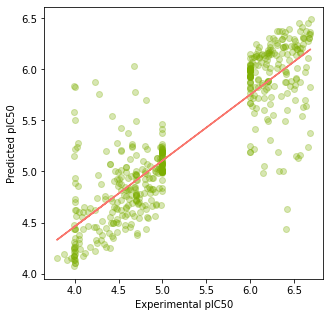

In [153]:
plt.figure(figsize=(5,5))
plt.scatter(x=Y_p, y=Y_pred, c="#7CAE00", alpha=0.3)

# Add trendline
# https://stackoverflow.com/questions/26447191/how-to-add-trendline-in-python-matplotlib-dot-scatter-graphs
z = np.polyfit(Y_p, Y_pred, 1)
p = np.poly1d(z)

plt.plot(Y_p,p(Y_p),"#F8766D")
plt.ylabel('Predicted pIC50')
plt.xlabel('Experimental pIC50')

In [154]:
import pickle

In [156]:
pickle.dump(BRmodel, open('IBD_model1.pkl', 'wb'))

## **Modeling** classification 

In [157]:
from sklearn import svm, tree, naive_bayes, ensemble , neighbors
# List of different Machine learning Algorithm we will use 
MLA = [
    ensemble.RandomForestClassifier(random_state=0),
    #Navies Bayes
    naive_bayes.BernoulliNB(),
    naive_bayes.GaussianNB(),
    #Trees    
    tree.DecisionTreeClassifier(random_state=0),
    tree.ExtraTreeClassifier(random_state=0),
    #Nearest Neighbor
    neighbors.KNeighborsClassifier(),
    #SVM
    svm.LinearSVC(random_state=0), 
    svm.NuSVC(probability=True),
    svm.SVC(probability=True) 
    ]
from sklearn.metrics import accuracy_score

In [158]:
MLA_columns = ['MLA Name', 'MLA Test Accuracy' ]
MLA_compare = pd.DataFrame(columns = MLA_columns)


row_index = 0
for alg in MLA:
    alg.fit(x_train, y_train)

    alg_acc = accuracy_score(y_test, alg.predict(x_test))
    MLA_name = alg.__class__.__name__
    MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
    
    MLA_compare.loc[row_index, 'MLA Test Accuracy'] = alg_acc

   
    
    row_index+=1

    
MLA_compare.sort_values(by = ['MLA Test Accuracy'], ascending = False, inplace = True)
MLA_compare

,MLA Name,MLA Test Accuracy
8,SVC,0.828283
7,NuSVC,0.79798
5,KNeighborsClassifier,0.787879
0,RandomForestClassifier,0.777778
6,LinearSVC,0.777778
2,GaussianNB,0.757576
1,BernoulliNB,0.717172
4,ExtraTreeClassifier,0.717172
3,DecisionTreeClassifier,0.707071


In [159]:
SVC=svm.SVC(probability=True)
SVC.fit(x_train, y_train)
alg_acc = accuracy_score(y_test, SVC.predict(x_test))
alg_acc

0.8282828282828283

In [161]:
Y_pred1 = SVC.predict(X)
Y_pred1

array(['inactive', 'active', 'active', 'active', 'active', 'active',
       'active', 'active', 'active', 'active', 'active', 'inactive',
       'active', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inactive',
       'inactive', 'inactive', 'inactive', 'inactive', 'inac

In [163]:
pickle.dump(SVC, open('IBD_model2.pkl', 'wb'))